# Correlation analysis between regions
- Scatter Plot

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import math

In [2]:
df = pd.read_csv('D:\git_space\COVID-19-prediction-project\data\kr_regional_daily.csv')
df = df.drop(['date', 'region', 'death', 'released'], axis=1)

df_list = df['confirmed'].tolist()

In [3]:
Seoul = []
Pusan = []
Daegu = []
Incheon = []
Gwangju = []
Daejeon = []
Ulsan = []
Sejong = []
Gyeonggi = []
Gangwon = []
Chungbuk = []
Chungnam = []
Jeonbuk = []
Jeonnam = []
Gyeongbuk = []
Gyeongnam = []
Jeju = []
Overseas = []

for i in range(len(df_list)):
  if i % 18 == 0:
    Seoul.append(df_list[i])

  elif i % 18 == 1:
    Pusan.append(df_list[i])
    
  elif i % 18 == 2:
    Daegu.append(df_list[i])
    
  elif i % 18 == 3:
    Incheon.append(df_list[i])
    
  elif i % 18 == 4:
    Gwangju.append(df_list[i])
    
  elif i % 18 == 5:
    Daejeon.append(df_list[i])
    
  elif i % 18 == 6:
    Ulsan.append(df_list[i])
    
  elif i % 18 == 7:
    Sejong.append(df_list[i])
    
  elif i % 18 == 8:
    Gyeonggi.append(df_list[i])
    
  elif i % 18 == 9:
    Gangwon.append(df_list[i])
    
  elif i % 18 == 10:
    Chungbuk.append(df_list[i])
    
  elif i % 18 == 11:
    Chungnam.append(df_list[i])
    
  elif i % 18 == 12:
    Jeonbuk.append(df_list[i])
    
  elif i % 18 == 13:
    Jeonnam.append(df_list[i])
    
  elif i % 18 == 14:
    Gyeongbuk.append(df_list[i])
    
  elif i % 18 == 15:
    Gyeongnam.append(df_list[i])
    
  elif i % 18 == 16:
    Jeju.append(df_list[i])
    
  elif i % 18 == 17:
    Overseas.append(df_list[i])

In [4]:
Seoul = pd.DataFrame(Seoul, columns=['confirmed'])
Pusan = pd.DataFrame(Pusan, columns=['confirmed'])
Daegu = pd.DataFrame(Daegu, columns=['confirmed'])
Incheon = pd.DataFrame(Incheon, columns=['confirmed'])
Gwangju = pd.DataFrame(Gwangju, columns=['confirmed'])
Daejeon = pd.DataFrame(Daejeon, columns=['confirmed'])
Ulsan = pd.DataFrame(Ulsan, columns=['confirmed'])
Sejong = pd.DataFrame(Sejong, columns=['confirmed'])
Gyeonggi = pd.DataFrame(Gyeonggi, columns=['confirmed'])
Gangwon = pd.DataFrame(Gangwon, columns=['confirmed'])
Chungbuk = pd.DataFrame(Chungbuk, columns=['confirmed'])
Chungnam = pd.DataFrame(Chungnam, columns=['confirmed'])
Jeonbuk = pd.DataFrame(Jeonbuk, columns=['confirmed'])
Jeonnam = pd.DataFrame(Jeonnam, columns=['confirmed'])
Gyeongbuk = pd.DataFrame(Gyeongbuk, columns=['confirmed'])
Gyeongnam = pd.DataFrame(Gyeongnam, columns=['confirmed'])
Jeju = pd.DataFrame(Jeju, columns=['confirmed'])
Overseas = pd.DataFrame(Overseas, columns=['confirmed'])

In [5]:
def make_diff(dataframe):
    
    df_list = dataframe['confirmed'].tolist()
    diff = []

    for i in range(len(df_list)):
        if i != 0:
            diff.append(df_list[i] - df_list[i - 1])

    sub = [1]
    diff = sub + diff

    diff = pd.DataFrame(diff, columns=['confirmed'])

    return diff


def diff_level(dataframe, level):

    model = dataframe

    for i in range(level):
        model = make_diff(model)

    return model

In [6]:
Seoul = diff_level(Seoul, 1)
Pusan = diff_level(Pusan, 1)
Daegu = diff_level(Daegu, 1)
Incheon = diff_level(Incheon, 1)
Gwangju = diff_level(Gwangju, 1)
Daejeon = diff_level(Daejeon, 1)
Ulsan = diff_level(Ulsan, 1)
Sejong = diff_level(Sejong, 1)
Gyeonggi = diff_level(Gyeonggi, 1)
Gangwon = diff_level(Gangwon, 1)
Chungbuk = diff_level(Chungbuk, 1)
Chungnam = diff_level(Chungnam, 1)
Jeonbuk = diff_level(Jeonbuk, 1)
Jeonnam = diff_level(Jeonnam, 1)
Gyeongbuk = diff_level(Gyeongbuk, 1)
Gyeongnam = diff_level(Gyeongnam, 1)
Jeju = diff_level(Jeju, 1)
Overseas = diff_level(Overseas, 1)

## minmaxscaling

In [7]:
from sklearn.preprocessing import MinMaxScaler
import seaborn as sns

corr_df = pd.DataFrame(
        {
            'Seoul': Seoul['confirmed'].values,
            'Pusan': Pusan['confirmed'].values,
            'Daegu': Daegu['confirmed'].values,
            'Incheon': Incheon['confirmed'].values,
            'Gwangju': Gwangju['confirmed'].values,
            'Daejeon': Daejeon['confirmed'].values,
            'Ulsan': Ulsan['confirmed'].values,
            'Sejong': Sejong['confirmed'].values,
            'Gyeonggi': Gyeonggi['confirmed'].values,
            'Gangwon': Gangwon['confirmed'].values,
            'Chungbuk': Chungbuk['confirmed'].values,
            'Chungnam': Chungnam['confirmed'].values,
            'Jeonbuk': Jeonbuk['confirmed'].values,
            'Jeonnam': Jeonnam['confirmed'].values,
            'Gyeongbuk': Gyeongbuk['confirmed'].values,
            'Gyeongnam': Gyeongnam['confirmed'].values,
            'Jeju': Jeju['confirmed'].values,
            'Overseas': Overseas['confirmed'].values        
        })

In [8]:
features = corr_df
scaler = MinMaxScaler()
scaler.fit(features)
df_scaled = scaler.transform(features)
corr_df_scaled = pd.DataFrame(data=df_scaled, columns=features.columns)
corr_df_scaled

,Seoul,Pusan,Daegu,Incheon,Gwangju,Daejeon,Ulsan,Sejong,Gyeonggi,Gangwon,Chungbuk,Chungnam,Jeonbuk,Jeonnam,Gyeongbuk,Gyeongnam,Jeju,Overseas
0,0.001812,0.026667,0.001524,0.009709,0.017699,0.015873,0.016393,0.058824,0.003021,0.018182,0.019231,0.0125,0.013333,0.039216,0.008130,0.014925,0.030303,0.012346
1,0.000000,0.013333,0.001524,0.000000,0.008850,0.007937,0.000000,0.000000,0.000000,0.000000,0.009615,0.0000,0.000000,0.019608,0.000000,0.000000,0.000000,0.000000
2,0.001812,0.013333,0.022866,0.000000,0.008850,0.007937,0.000000,0.000000,0.003021,0.000000,0.009615,0.0000,0.000000,0.019608,0.024390,0.000000,0.000000,0.000000
3,0.012681,0.120000,0.021341,0.009709,0.017699,0.007937,0.000000,0.000000,0.000000,0.018182,0.009615,0.0000,0.000000,0.019608,0.178862,0.044776,0.000000,0.000000
4,0.009058,0.013333,0.121951,0.000000,0.008850,0.007937,0.000000,0.000000,0.006042,0.000000,0.019231,0.0125,0.013333,0.019608,0.024390,0.059701,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
461,0.327899,0.213333,0.086890,0.116505,0.088496,0.103175,0.393443,0.058824,0.456193,0.345455,0.096154,0.3000,0.186667,0.215686,0.097561,0.253731,0.242424,0.123457
462,0.251812,0.213333,0.073171,0.174757,0.150442,0.095238,0.196721,0.823529,0.368580,0.363636,0.076923,0.3875,0.160000,0.294118,0.097561,0.253731,0.575758,0.135802
463,0.250000,0.226667,0.044207,0.106796,0.194690,0.126984,0.114754,0.823529,0.410876,0.381818,0.096154,0.2750,0.066667,0.156863,0.097561,0.208955,0.515152,0.271605
464,0.474638,0.306667,0.045732,0.184466,0.194690,0.142857,0.245902,0.529412,0.574018,0.454545,0.134615,0.2375,0.080000,0.235294,0.073171,0.298507,0.181818,0.160494


## Scatter plot

array([[<AxesSubplot:xlabel='Seoul', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Pusan', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Daegu', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Incheon', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Gwangju', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Daejeon', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Ulsan', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Sejong', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Gyeonggi', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Gangwon', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Chungbuk', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Chungnam', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Jeonbuk', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Jeonnam', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Gyeongbuk', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Gyeongnam', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Jeju', ylabel='Seoul'>,
        <AxesSubplot:xlabel='Overseas', ylabel='Seoul

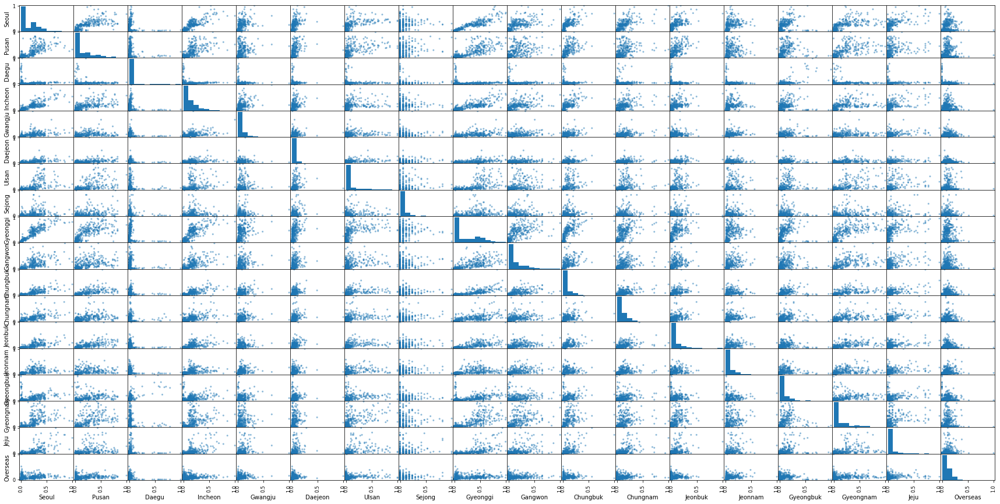

In [9]:
from pandas.plotting import scatter_matrix

scatter_matrix(corr_df_scaled, figsize=(30, 15))